In [41]:
import numpy as np
import xarray as xr
import os.path as op
from matplotlib import colors, ticker
import matplotlib.pyplot as plt
%matplotlib inline

import cartopy.crs as crs
import hvplot.xarray
import geopandas as gpd
import hvplot.pandas

In [42]:
url = 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2021/117/A2021117.L3m_DAY_CHL_chl_ocx_4km.nc'
ds = xr.open_dataset(url)
ds

<xarray.Dataset>
Dimensions:  (eightbitcolor: 256, lat: 4320, lon: 8640, rgb: 3)
Coordinates:
  * lat      (lat) float32 89.98 89.94 89.9 89.85 ... -89.85 -89.9 -89.94 -89.98
  * lon      (lon) float32 -180.0 -179.9 -179.9 -179.9 ... 179.9 179.9 180.0
Dimensions without coordinates: eightbitcolor, rgb
Data variables:
    palette  (rgb, eightbitcolor) int8 ...
    chl_ocx  (lat, lon) float32 ...
Attributes:
    product_name:                      A2021117.L3m_DAY_CHL_chl_ocx_4km.nc
    instrument:                        MODIS
    title:                             MODISA Level-3 Standard Mapped Image
    project:                           Ocean Biology Processing Group (NASA/G...
    platform:                          Aqua
    temporal_range:                    day
    processing_version:                2018.1QL
    date_created:                      2021-05-13T23:38:29.000Z
    history:                           l3mapgen par=A2021117.L3m_DAY_CHL_chl_...
    l2_flag_names:                     ATMFAIL,LAND,HILT,HISATZEN,STRAYLIGHT,...
    time_coverage_start:               2021-04-27T00:20:01.000Z
    time_coverage_end:                 2021-04-28T02:59:59.000Z
    start_orbit_number:                100959
    end_orbit_number:                  100975
    map_projection:                    Equidistant Cylindrical
    latitude_units:                    degrees_north
    longitude_units:                   degrees_east
    northernmost_latitude:             90.0
    southernmost_latitude:             -90.0
    westernmost_longitude:             -180.0
    easternmost_longitude:             180.0
    geospatial_lat_max:                90.0
    geospatial_lat_min:                -90.0
    geospatial_lon_max:                180.0
    geospatial_lon_min:                -180.0
    latitude_step:                     0.041666668
    longitude_step:                    0.041666668
    sw_point_latitude:                 -89.979164
    sw_point_longitude:                -179.97917
    spatialResolution:                 4.64 km
    geospatial_lon_resolution:         0.041666668
    geospatial_lat_resolution:         0.041666668
    geospatial_lat_units:              degrees_north
    geospatial_lon_units:              degrees_east
    number_of_lines:                   4320
    number_of_columns:                 8640
    measure:                           Mean
    suggested_image_scaling_minimum:   0.01
    suggested_image_scaling_maximum:   20.0
    suggested_image_scaling_type:      LOG
    suggested_image_scaling_applied:   No
    _lastModified:                     2021-05-13T23:38:29.000Z
    Conventions:                       CF-1.6 ACDD-1.3
    institution:                       NASA Goddard Space Flight Center, Ocea...
    standard_name_vocabulary:          CF Standard Name Table v36
    naming_authority:                  gov.nasa.gsfc.sci.oceandata
    id:                                A2021117.L3b_DAY_CHL.nc/L3/A2021117.L3...
    license:                           https://science.nasa.gov/earth-science...
    creator_name:                      NASA/GSFC/OBPG
    publisher_name:                    NASA/GSFC/OBPG
    creator_email:                     data@oceancolor.gsfc.nasa.gov
    publisher_email:                   data@oceancolor.gsfc.nasa.gov
    creator_url:                       https://oceandata.sci.gsfc.nasa.gov
    publisher_url:                     https://oceandata.sci.gsfc.nasa.gov
    processing_level:                  L3 Mapped
    cdm_data_type:                     grid
    identifier_product_doi_authority:  http://dx.doi.org
    identifier_product_doi:            10.5067/AQUA/MODIS/L3M/CHL/2018
    keywords:                          Earth Science > Oceans > Ocean Chemist...
    keywords_vocabulary:               NASA Global Change Master Directory (G...
    _NCProperties:                     version=2,netcdf=4.7.3,hdf5=1.12.0,
    data_bins:                         Attribute edlided: Unsupported attribu...
    data_mini

In [43]:
sst_url = 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2021/0427/AQUA_MODIS.20210427.L3m.DAY.SST.sst.4km.NRT.nc'
sst_ds = xr.open_dataset(sst_url)
sst_ds

<xarray.Dataset>
Dimensions:   (eightbitcolor: 256, lat: 4320, lon: 8640, rgb: 3)
Coordinates:
  * lat       (lat) float32 89.98 89.94 89.9 89.85 ... -89.9 -89.94 -89.98
  * lon       (lon) float32 -180.0 -179.9 -179.9 -179.9 ... 179.9 179.9 180.0
Dimensions without coordinates: eightbitcolor, rgb
Data variables:
    palette   (rgb, eightbitcolor) int8 ...
    sst       (lat, lon) float32 ...
    qual_sst  (lat, lon) float32 ...
Attributes:
    product_name:                     AQUA_MODIS.20210427.L3m.DAY.SST.sst.4km...
    instrument:                       MODIS
    title:                            MODISA Level-3 Standard Mapped Image
    project:                          Ocean Biology Processing Group (NASA/GS...
    platform:                         Aqua
    temporal_range:                   day
    processing_version:               R2019.0
    date_created:                     2021-04-28T04:53:19.000Z
    history:                          l3mapgen par=AQUA_MODIS.20210427.L3m.DA...
    l2_flag_names:                    LAND,HISOLZEN
    time_coverage_start:              2021-04-27T00:20:01.000Z
    time_coverage_end:                2021-04-28T02:34:58.000Z
    start_orbit_number:               100999
    end_orbit_number:                 101014
    map_projection:                   Equidistant Cylindrical
    latitude_units:                   degrees_north
    longitude_units:                  degrees_east
    northernmost_latitude:            90.0
    southernmost_latitude:            -90.0
    westernmost_longitude:            -180.0
    easternmost_longitude:            180.0
    geospatial_lat_max:               90.0
    geospatial_lat_min:               -90.0
    geospatial_lon_max:               180.0
    geospatial_lon_min:               -180.0
    latitude_step:                    0.041666668
    longitude_step:                   0.041666668
    sw_point_latitude:                -89.979164
    sw_point_longitude:               -179.97917
    spatialResolution:                4.64 km
    geospatial_lon_resolution:        0.041666668
    geospatial_lat_resolution:        0.041666668
    geospatial_lat_units:             degrees_north
    geospatial_lon_units:             degrees_east
    number_of_lines:                  4320
    number_of_columns:                8640
    measure:                          Mean
    suggested_image_scaling_minimum:  -2.0
    suggested_image_scaling_maximum:  45.0
    suggested_image_scaling_type:     LINEAR
    suggested_image_scaling_applied:  No
    _lastModified:                    2021-04-28T04:53:19.000Z
    Conventions:                      CF-1.6 ACDD-1.3
    institution:                      NASA Goddard Space Flight Center, Ocean...
    standard_name_vocabulary:         CF Standard Name Table v36
    naming_authority:                 gov.nasa.gsfc.sci.oceandata
    id:                               AQUA_MODIS.20210427.L3b.DAY.SST.NRT.nc/...
    license:                          https://science.nasa.gov/earth-science/...
    creator_name:                     NASA/GSFC/OBPG
    publisher_name:                   NASA/GSFC/OBPG
    creator_email:                    data@oceancolor.gsfc.nasa.gov
    publisher_email:                  data@oceancolor.gsfc.nasa.gov
    creator_url:                      https://oceandata.sci.gsfc.nasa.gov
    publisher_url:                    https://oceandata.sci.gsfc.nasa.gov
    processing_level:                 L3 Mapped
    cdm_data_type:                    grid
    keywords:                         Earth Science > Oceans > Ocean Optics >...
    keywords_vocabulary:              NASA Global Change Master Directory (GC...
    _NCProperties:                    version=2,netcdf=4.7.3,hdf5=1.12.0,
    data_bins:                        Attribute edlided: Unsupported attribut...
    data_minimum:                     -1.8000001
    data_maximum:                     39.7725

In [44]:
ds.chl_ocx.attrs['long_name'] = "Chl-a"
ds.attrs['latitude_units'] = "" 
ds.attrs['longitude_units'] = ""
ds.attrs['geospatial_lat_units'] = "" 
ds.attrs['geospatial_lon_units'] = ""
ds

<xarray.Dataset>
Dimensions:  (eightbitcolor: 256, lat: 4320, lon: 8640, rgb: 3)
Coordinates:
  * lat      (lat) float32 89.98 89.94 89.9 89.85 ... -89.85 -89.9 -89.94 -89.98
  * lon      (lon) float32 -180.0 -179.9 -179.9 -179.9 ... 179.9 179.9 180.0
Dimensions without coordinates: eightbitcolor, rgb
Data variables:
    palette  (rgb, eightbitcolor) int8 -109 0 108 -112 0 111 ... 105 0 0 0 0 0
    chl_ocx  (lat, lon) float32 ...
Attributes:
    product_name:                      A2021117.L3m_DAY_CHL_chl_ocx_4km.nc
    instrument:                        MODIS
    title:                             MODISA Level-3 Standard Mapped Image
    project:                           Ocean Biology Processing Group (NASA/G...
    platform:                          Aqua
    temporal_range:                    day
    processing_version:                2018.1QL
    date_created:                      2021-05-13T23:38:29.000Z
    history:                           l3mapgen par=A2021117.L3m_DAY_CHL_chl_...
    l2_flag_names:                     ATMFAIL,LAND,HILT,HISATZEN,STRAYLIGHT,...
    time_coverage_start:               2021-04-27T00:20:01.000Z
    time_coverage_end:                 2021-04-28T02:59:59.000Z
    start_orbit_number:                100959
    end_orbit_number:                  100975
    map_projection:                    Equidistant Cylindrical
    latitude_units:                    
    longitude_units:                   
    northernmost_latitude:             90.0
    southernmost_latitude:             -90.0
    westernmost_longitude:             -180.0
    easternmost_longitude:             180.0
    geospatial_lat_max:                90.0
    geospatial_lat_min:                -90.0
    geospatial_lon_max:                180.0
    geospatial_lon_min:                -180.0
    latitude_step:                     0.041666668
    longitude_step:                    0.041666668
    sw_point_latitude:                 -89.979164
    sw_point_longitude:                -179.97917
    spatialResolution:                 4.64 km
    geospatial_lon_resolution:         0.041666668
    geospatial_lat_resolution:         0.041666668
    geospatial_lat_units:              
    geospatial_lon_units:              
    number_of_lines:                   4320
    number_of_columns:                 8640
    measure:                           Mean
    suggested_image_scaling_minimum:   0.01
    suggested_image_scaling_maximum:   20.0
    suggested_image_scaling_type:      LOG
    suggested_image_scaling_applied:   No
    _lastModified:                     2021-05-13T23:38:29.000Z
    Conventions:                       CF-1.6 ACDD-1.3
    institution:                       NASA Goddard Space Flight Center, Ocea...
    standard_name_vocabulary:          CF Standard Name Table v36
    naming_authority:                  gov.nasa.gsfc.sci.oceandata
    id:                                A2021117.L3b_DAY_CHL.nc/L3/A2021117.L3...
    license:                           https://science.nasa.gov/earth-science...
    creator_name:                      NASA/GSFC/OBPG
    publisher_name:                    NASA/GSFC/OBPG
    creator_email:                     data@oceancolor.gsfc.nasa.gov
    publisher_email:                   data@oceancolor.gsfc.nasa.gov
    creator_url:                       https://oceandata.sci.gsfc.nasa.gov
    publisher_url:                     https://oceandata.sci.gsfc.nasa.gov
    processing_level:                  L3 Mapped
    cdm_data_type:                     grid
    identifier_product_doi_authority:  http://dx.doi.org
    identifier_product_doi:            10.5067/AQUA/MODIS/L3M/CHL/2018
    keywords:                          Earth Science > Oceans > Ocean Chemist...
    keywords_vocabulary:               NASA Global Change Master Directory (G...
    _NCProperties:                     version=2,netcdf=4.7.3,hdf5=1.12.0,
    data_bins:                         Attribute edlided: Unsupported attribu...
    data_minimum:          

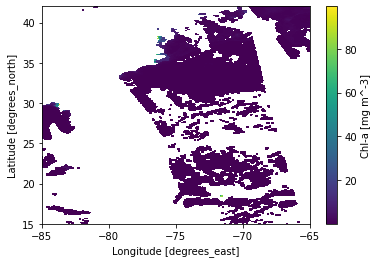

In [45]:
ds = ds.sel( lat=slice(42, 15), lon=slice(-85,-65))
ds.chl_ocx.plot()

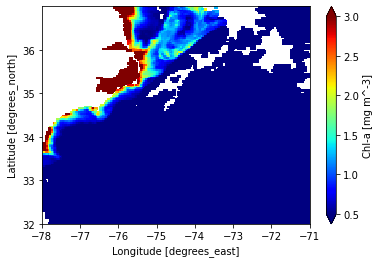

In [46]:
ds.sel( lat=slice(37, 32), lon=slice(-78,-71)).chl_ocx.plot(vmax=3, vmin=0.5, cmap='jet')

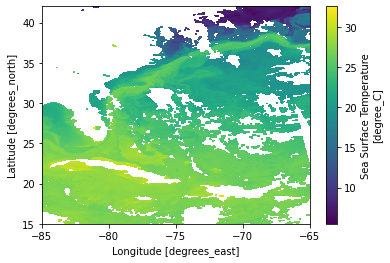

In [47]:
sst_ds = sst_ds.sel( lat=slice(42, 15), lon=slice(-85,-65))
sst_ds.sst.plot()

In [99]:
gdf = gpd.read_file('chla_sst_flight2.shp')
gdf

,chla,Latitude,Longitude,sst,time_str,geometry
0,0.089634,34.020764,-76.184039,294.66,2021-04-27 14:44:25,POINT (-76.18404 34.02076)
1,0.100023,34.020764,-76.184039,294.62,2021-04-27 14:44:27,POINT (-76.18404 34.02076)
2,0.085685,34.020764,-76.184039,294.60,2021-04-27 14:44:29,POINT (-76.18404 34.02076)
3,0.079555,34.020711,-76.184006,294.71,2021-04-27 14:44:31,POINT (-76.18401 34.02071)
4,0.094565,34.020647,-76.183964,294.82,2021-04-27 14:44:33,POINT (-76.18396 34.02065)
...,...,...,...,...,...,...
323,0.080117,34.024150,-76.187331,292.65,2021-04-27 14:59:14,POINT (-76.18733 34.02415)
324,0.081967,34.024292,-76.187194,292.54,2021-04-27 14:59:16,POINT (-76.18719 34.02429)
325,0.078997,34.024453,-76.187053,292.38,2021-04-27 14:59:18,POINT (-76.18705 34.02445)
326,0.092468,34.024614,-76.186908,292.40,2021-04-27 14:59:20,POINT (-76.18691 34.02461)


In [102]:
import pandas as pd
gdf['time'] = pd.to_datetime(gdf['time_str'])

In [63]:
gdf.hvplot(color=gdf['chla'], cmap='viridis',size=100, alpha=0.7)

:Points   [x,y]   (_color)

In [104]:
# for some reason I can't have the geometry column due to a bug in holoviz
df = gdf.drop('geometry', axis=1)

In [105]:
df.hvplot.points('Longitude', 'Latitude', color=df['sst'], cmap='inferno',size=100, alpha=0.7)

:Points   [Longitude,Latitude]   (_color)

In [106]:
ds = ds.sel( lat=slice(35, 33), lon=slice(-77,-75))
sst_ds = sst_ds.sel( lat=slice(35, 33), lon=slice(-77,-75))

In [107]:
df.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.04,.11))

:Points   [Longitude,Latitude]   (chla)

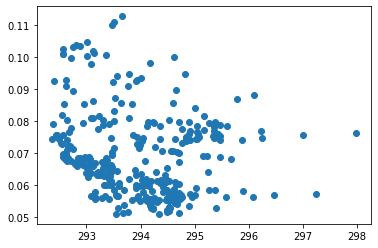

In [108]:
plt.scatter(df['sst'], df['chla'])

In [109]:
df.head(1)

,chla,Latitude,Longitude,sst,time_str,time
0,0.089634,34.020764,-76.184039,294.66,2021-04-27 14:44:25,2021-04-27 14:44:25


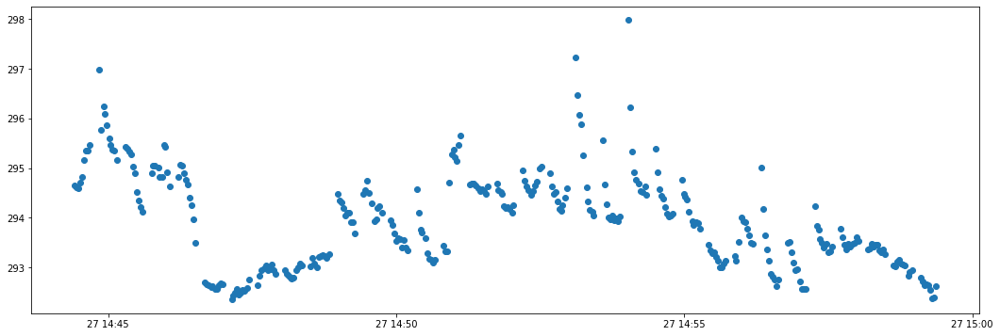

In [114]:
fig,ax = plt.subplots(figsize=(18,6))
ax.scatter(df['time'], df['sst'])

The osscilation in temp is clear in this plot...

In [115]:
df.hvplot.points('time','sst')

:Points   [time,sst]

In [90]:
ds.chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=False, coastline='110m', 
    frame_width=500, logz=True, clim=(0.01,1), rasterize=False)*\
df.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.04,.11)) + \
sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=False, coastline='110m', 
    frame_width=500,rasterize=False)*\
df.hvplot.points('Longitude', 'Latitude', color='sst', geo=True, cmap='inferno', clim=(292,295), alpha=0.8)

:Layout
   .Overlay.I  :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chl_ocx)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (chla)
   .Overlay.II :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (sst)

In [121]:
gdf1 = gpd.read_file('chla_sst_flight1.shp')
gdf1

,chla,Latitude,Longitude,sst,time_str,geometry
0,0.122446,34.039461,-76.276736,289.23,2021-04-27 13:10:57,POINT (-76.27674 34.03946)
1,0.121662,34.039461,-76.276739,289.36,2021-04-27 13:10:59,POINT (-76.27674 34.03946)
2,0.121413,34.039461,-76.276739,289.47,2021-04-27 13:11:01,POINT (-76.27674 34.03946)
3,0.121824,34.039461,-76.276739,289.31,2021-04-27 13:11:03,POINT (-76.27674 34.03946)
4,0.120904,34.039461,-76.276733,289.74,2021-04-27 13:11:12,POINT (-76.27673 34.03946)
...,...,...,...,...,...,...
254,0.100506,34.034953,-76.262631,292.25,2021-04-27 13:22:42,POINT (-76.26263 34.03495)
255,0.100830,34.034883,-76.262503,291.68,2021-04-27 13:22:45,POINT (-76.26250 34.03488)
256,0.099254,34.034822,-76.262392,291.47,2021-04-27 13:22:47,POINT (-76.26239 34.03482)
257,0.101585,34.034767,-76.262289,291.43,2021-04-27 13:22:48,POINT (-76.26229 34.03477)


In [141]:
gdf1['sst_c'] = gdf1['sst']-273.15
gdf1['time'] = pd.to_datetime(gdf1['time_str'])
df1 = gdf1.drop('geometry', axis=1)

In [142]:
df1.hvplot.points('Longitude', 'Latitude', color='sst_c', cmap='inferno',size=50, alpha=0.7) + \
df1.hvplot.points('Longitude', 'Latitude', color='chla', cmap='viridis', size=50, alpha=0.8, clim=(0.09,.13))

:Layout
   .Points.I  :Points   [Longitude,Latitude]   (sst_c)
   .Points.II :Points   [Longitude,Latitude]   (chla)

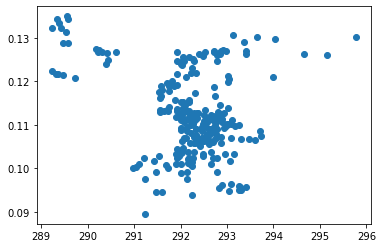

In [130]:
plt.scatter(df1['sst'], df1['chla'])

In [133]:
df1.hvplot.points('time','sst')

:Points   [time,sst]

In [146]:
ds.chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='viridis', dynamic=False, coastline='110m', 
    frame_width=500, logz=False, clim=(0.09,.20), rasterize=False)*\
df1.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.09,.20)) + \
sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=False, coastline='110m', 
    frame_width=500,rasterize=False, clim=(19,25))*\
df1.hvplot.points('Longitude', 'Latitude', color='sst_c', geo=True, cmap='inferno', clim=(19-5,25-5), alpha=0.8)

:Layout
   .Overlay.I  :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chl_ocx)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (chla)
   .Overlay.II :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (sst_c)

In [15]:
proj = crs.Orthographic(-90, 30)

ds.chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline='10m', 
    frame_width=500, logz=True, clim=(0.01,2), rasterize=True) *\
gdf.hvplot(color=gdf['chla'], cmap='viridis',size=100, alpha=0.7)

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [lon,lat]   (chl_ocx)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [x,y]   (_color)

In [23]:
proj = crs.Orthographic(-90, 30)

sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=True, coastline='10m', 
    frame_width=500,rasterize=True)

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]

In [27]:
ds.sel( lat=slice(37, 32), lon=slice(-78,-71)).chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline='10m', 
    frame_width=500, logz=True, clim=(0.01,2), rasterize=True) + \
sst_ds.sel( lat=slice(37, 32), lon=slice(-78,-71)).sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=True, coastline='10m', 
    frame_width=500,rasterize=True)

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .Image.I     :Image   [lon,lat]   (chl_ocx)
         .Coastline.I :Feature   [Longitude,Latitude]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .Image.I     :Image   [lon,lat]   (sst)
         .Coastline.I :Feature   [Longitude,Latitude]

In [8]:
xr.open_dataset('data/20210427_gulf_stream_surveys/A2021117183000.L2_LAC_OC.nc')

<xarray.Dataset>
Dimensions:  ()
Data variables:
    *empty*
Attributes:
    title:                             MODISA Level-2 Data
    product_name:                      A2021117183000.L2_LAC_OC.nc
    processing_version:                2018.1QLP
    equatorCrossingLongitude:          116.08679
    orbit_number:                      101010
    history:                           l2gen par=/data4/sdpsoper/vdc/vpu3/wor...
    instrument:                        MODIS
    platform:                          Aqua
    Conventions:                       CF-1.6 ACDD-1.3
    license:                           https://science.nasa.gov/earth-science...
    naming_authority:                  gov.nasa.gsfc.sci.oceandata
    id:                                2018.1QLP/L2/A2021117183000.L2_LAC_OC.nc
    date_created:                      2021-04-27T20:03:21.000Z
    keywords_vocabulary:               NASA Global Change Master Directory (G...
    keywords:                          Earth Science > Oceans > Ocean Optics ...
    standard_name_vocabulary:          CF Standard Name Table v36
    institution:                       NASA Goddard Space Flight Center, Ocea...
    creator_name:                      NASA/GSFC/OBPG
    creator_email:                     data@oceancolor.gsfc.nasa.gov
    creator_url:                       https://oceandata.sci.gsfc.nasa.gov
    project:                           Ocean Biology Processing Group (NASA/G...
    publisher_name:                    NASA/GSFC/OBPG
    publisher_url:                     https://oceandata.sci.gsfc.nasa.gov
    publisher_email:                   data@oceancolor.gsfc.nasa.gov
    identifier_product_doi_authority:  http://dx.doi.org
    identifier_product_doi:            10.5067/AQUA/MODIS/L2/OC/2018
    processing_level:                  L2
    cdm_data_type:                     swath
    equatorCrossingDateTime:           2021-04-27T19:14:36.209Z
    spatialResolution:                 1 km
    time_coverage_start:               2021-04-27T18:30:00.655Z
    time_coverage_end:                 2021-04-27T18:34:59.032Z
    start_center_longitude:            -78.536514
    start_center_latitude:             30.773306
    end_center_longitude:              -84.27106
    end_center_latitude:               48.688175
    northernmost_latitude:             49.893425
    southernmost_latitude:             28.47627
    easternmost_longitude:             -66.35508
    westernmost_longitude:             -98.945465
    geospatial_lat_units:              degrees_north
    geospatial_lon_units:              degrees_east
    geospatial_lat_max:                49.893425
    geospatial_lat_min:                28.47627
    geospatial_lon_max:                -66.35508
    geospatial_lon_min:                -98.945465
    startDirection:                    Ascending
    endDirection:                      Ascending
    day_night_flag:                    Day
    earth_sun_distance_correction:     0.9867772459983826